# Setup

## Install Detectron2

In [2]:
!python -m pip install pyyaml==5.1
import sys, os, distutils.core
# Note: This is a faster way to install detectron2 in Colab, but it does not include all functionalities (e.g. compiled operators).
# See https://detectron2.readthedocs.io/tutorials/install.html for full installation instructions
# !git clone 'https://github.com/facebookresearch/detectron2'
# dist = distutils.core.run_setup("./detectron2/setup.py")
# !python -m pip install {' '.join([f"'{x}'" for x in dist.install_requires])}
# sys.path.insert(0, os.path.abspath('./detectron2'))

# Properly install detectron2. (Please do not install twice in both ways)
!python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

Defaulting to user installation because normal site-packages is not writeable
     |████████████████████████████████| 274 kB 5.9 MB/s eta 0:00:01
  Created wheel for pyyaml: filename=PyYAML-5.1-cp38-cp38-linux_x86_64.whl size=44074 sha256=fcd41c930a264b23cdf49613f434121cd6af53d2e1ae96dd10c78e61a91f9ec0
  Stored in directory: /home/shabanza/.cache/pip/wheels/52/dd/2b/10ff8b0ac81b93946bb5fb9e6749bae2dac246506c8774e6cf
Successfully built pyyaml


ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
dask 2022.7.0 requires pyyaml>=5.3.1, but you have pyyaml 5.1 which is incompatible.
Defaulting to user installation because normal site-packages is not writeable
  Cloning https://github.com/facebookresearch/detectron2.git to /tmp/pip-req-build-gt3u6e46
  Running command git clone -q https://github.com/facebookresearch/detectron2.git /tmp/pip-req-build-gt3u6e46
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done
     |████████████████████████████████| 5.5 MB 11.3 MB/s eta 0:00:01
     |████████████████████████████████| 50 kB 25.3 MB/s eta 0:00:01
     |████████████████████████████████| 79 kB 28.3 MB/s eta 0:00:01
     |████████████████████████████████| 154 kB 142.4 MB/s eta 0:00:01
     |████████████████████████████████| 1.6 MB 87.9 MB/s et

In [1]:
import torch, detectron2
!nvcc --version
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
print("detectron2:", detectron2.__version__)

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2021 NVIDIA Corporation
Built on Mon_May__3_19:15:13_PDT_2021
Cuda compilation tools, release 11.3, V11.3.109
Build cuda_11.3.r11.3/compiler.29920130_0
torch:  1.10 ; cuda:  cu113
detectron2: 0.6


## Install Mask2Former

In [2]:
# clone and install Mask2Former
# !git clone https://github.com/facebookresearch/Mask2Former.git
%cd Mask2Former
%pip install -U opencv-python
# %pip install git+https://github.com/cocodataset/panopticapi.git
%pip install -r requirements.txt
%cd mask2former/modeling/pixel_decoder/ops
!python setup.py build install

/scratch/shabanza/segmentation/Mask2Former
Defaulting to user installation because normal site-packages is not writeable
     |████████████████████████████████| 61.7 MB 6.0 MB/s eta 0:00:01
Note: you may need to restart the kernel to use updated packages.
Defaulting to user installation because normal site-packages is not writeable


     |████████████████████████████████| 2.3 MB 6.1 MB/s eta 0:00:01
     |████████████████████████████████| 2.2 MB 120.5 MB/s eta 0:00:01
     |████████████████████████████████| 73 kB 9.5 MB/s s eta 0:00:01
     |████████████████████████████████| 1.3 MB 110.5 MB/s eta 0:00:01
     |████████████████████████████████| 268 kB 96.6 MB/s eta 0:00:01
  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.
  NOTE: The current PATH contains path(s) starting with `~`, which may not be expanded by all applications.
Note: you may need to restart the kernel to use updated packages.
/scratch/shabanza/segmentation/Mask2Former/mask2former/modeling/pixel_decoder/ops
running build
running build_py
running build_ext
building 'MultiScaleDeformableAttention' extension
Emitting ninja build file /scratch/shabanza/segmentation/Mask2Former/mask2former/modeling/pixel_decoder/ops/build/temp.linux-x86_64-3.8/build.ninja...
Compiling objects...
Allowing n

In [3]:
%cd /scratch/shabanza/segmentation/Mask2Former
%cd mask2former/modeling/pixel_decoder/ops
!sudo sh make.sh
%cd /scratch/shabanza/segmentation/Mask2Former

/scratch/shabanza/segmentation/Mask2Former
/scratch/shabanza/segmentation/Mask2Former/mask2former/modeling/pixel_decoder/ops
running build
running build_py
running build_ext
building 'MultiScaleDeformableAttention' extension
Emitting ninja build file /scratch/shabanza/segmentation/Mask2Former/mask2former/modeling/pixel_decoder/ops/build/temp.linux-x86_64-3.8/build.ninja...
Compiling objects...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
ninja: no work to do.
g++ -pthread -shared -B /opt/conda/compiler_compat -L/opt/conda/lib -Wl,-rpath=/opt/conda/lib -Wl,--no-as-needed -Wl,--sysroot=/ /scratch/shabanza/segmentation/Mask2Former/mask2former/modeling/pixel_decoder/ops/build/temp.linux-x86_64-3.8/scratch/shabanza/segmentation/Mask2Former/mask2former/modeling/pixel_decoder/ops/src/vision.o /scratch/shabanza/segmentation/Mask2Former/mask2former/modeling/pixel_decoder/ops/build/temp.linux-x86_64-3.8/scratch/shabanza/segment

Adding MultiScaleDeformableAttention 1.0 to easy-install.pth file

Installed /opt/conda/lib/python3.8/site-packages/MultiScaleDeformableAttention-1.0-py3.8-linux-x86_64.egg
Processing dependencies for MultiScaleDeformableAttention==1.0
Finished processing dependencies for MultiScaleDeformableAttention==1.0
/scratch/shabanza/segmentation/Mask2Former


For gccxx not found error:
> sudo apt-get update

> sudo apt-get install software-properties-common

> sudo add-apt-repository ppa:ubuntu-toolchain-r/test

> sudo apt-get upgrade libstdc++6

For libGL error:
> sudo apt-get install ffmpeg libsm6 libxext6  -y

## Imports

In [1]:
# import some common libraries
import os
import cv2
import json
import torch
import random
import numpy as np
import matplotlib.pyplot as plt

from PIL import Image, ImageDraw
from IPython.display import display
from IPython.display import Image as dis_image

from detectron2.utils.visualizer import Visualizer

In [2]:
%load_ext autoreload
%autoreload 2

In [3]:
torch.cuda.empty_cache()

In [4]:
# You may need to restart your runtime prior to this, to let your installation take effect
%cd Mask2Former
# Some basic setup:
# Setup detectron2 logger
from detectron2.utils.logger import setup_logger
setup_logger()
setup_logger(name="mask2former")


# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer, ColorMode
from detectron2.data import MetadataCatalog
from detectron2.projects.deeplab import add_deeplab_config
coco_metadata = MetadataCatalog.get("coco_2017_val_panoptic")

# import Mask2Former project
from mask2former import add_maskformer2_config

/scratch/shabanza/segmentation/Mask2Former


# Model

In [5]:
cfg = get_cfg()
add_deeplab_config(cfg)
add_maskformer2_config(cfg)
cfg.merge_from_file("configs/coco/instance-segmentation/swin/maskformer2_swin_large_IN21k_384_bs16_100ep.yaml")
cfg.MODEL.WEIGHTS = 'https://dl.fbaipublicfiles.com/maskformer/mask2former/coco/instance/maskformer2_swin_large_IN21k_384_bs16_100ep/model_final_e5f453.pkl'

cfg.MODEL.MASK_FORMER.TEST.SEMANTIC_ON = True
cfg.MODEL.MASK_FORMER.TEST.INSTANCE_ON = True
cfg.MODEL.MASK_FORMER.TEST.PANOPTIC_ON = True
predictor = DefaultPredictor(cfg)

/opt/conda/lib/python3.8/site-packages/torch/functional.py:445: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2157.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[08/18 09:32:03 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/maskformer/mask2former/coco/instance/maskformer2_swin_large_IN21k_384_bs16_100ep/model_final_e5f453.pkl ...
WARNING [08/18 09:32:04 mask2former.modeling.transformer_decoder.mask2former_transformer_decoder]: Weight format of MultiScaleMaskedTransformerDecoder have changed! Please upgrade your models. Applying automatic conversion now ...


# Dataset

In [6]:
from detectron2.data import DatasetCatalog, MetadataCatalog
from src.dataset.register_comic_instance import *

registering comic ...
loading sinergia json ...
Sinergia Json loaded.
registering placid ...


100%|██████████| 47256/47256 [00:00<00:00, 646022.07it/s]


registering yves ...


100%|██████████| 47256/47256 [00:00<00:00, 761701.02it/s]


In [7]:
dataset_name = DATASET_NAME

dataset_dicts = DatasetCatalog.get(dataset_name)
metadata = MetadataCatalog.get(dataset_name)

[08/18 09:32:32 d2.data.datasets.coco]: Loading /sinergia/shabanza/datasets/sinergia/coco/annotations/instances_default_modified.json takes 1.37 seconds.
[08/18 09:32:32 d2.data.datasets.coco]: Loaded 282 images in COCO format from /sinergia/shabanza/datasets/sinergia/coco/annotations/instances_default_modified.json


In [8]:
placid_dataset_dicts = DatasetCatalog.get(PLACID_NAME)
placid_metadata = MetadataCatalog.get(PLACID_NAME)

[08/18 09:32:33 d2.data.datasets.coco]: Loading /sinergia/shabanza/datasets/sinergia/coco/annotations/instances_placid.json takes 1.03 seconds.
[08/18 09:32:33 d2.data.datasets.coco]: Loaded 154 images in COCO format from /sinergia/shabanza/datasets/sinergia/coco/annotations/instances_placid.json


In [9]:
yves_dataset_dicts = DatasetCatalog.get(YVES_NAME)
yves_metadata = MetadataCatalog.get(YVES_NAME)

[08/18 09:32:34 d2.data.datasets.coco]: Loaded 128 images in COCO format from /sinergia/shabanza/datasets/sinergia/coco/annotations/instances_yves.json


## Visualize Samples

In [9]:
from src.dataset.helpers import visualize_sample_anns, visualize_dataset_dict

In [24]:
sample = random.choice(placid_dataset_dicts)

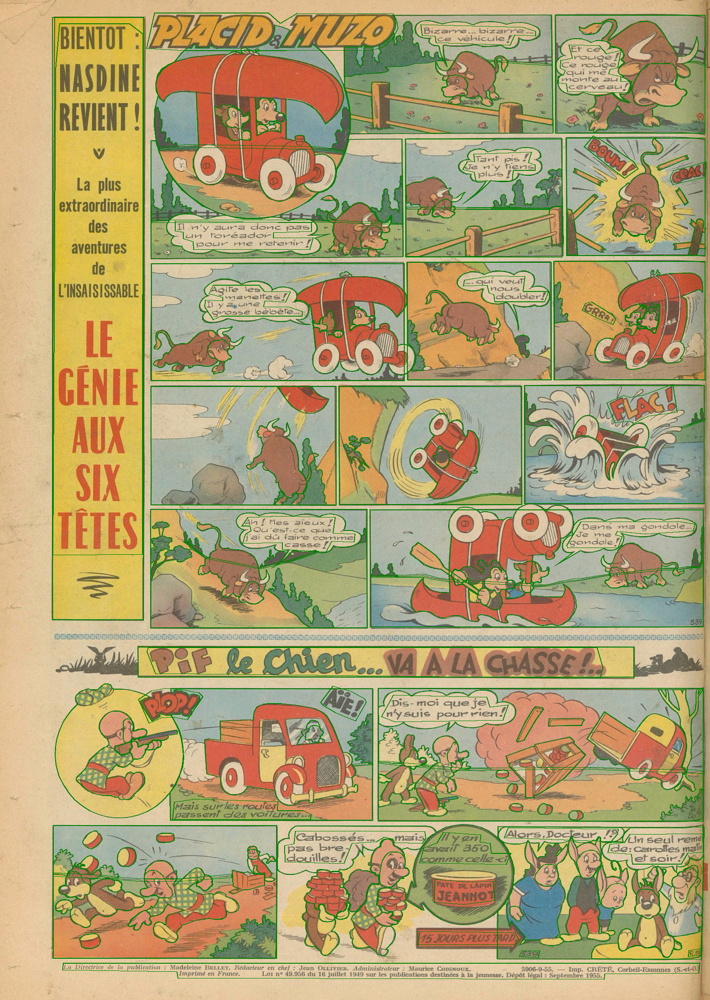

In [16]:
visualize_sample_anns(sample)

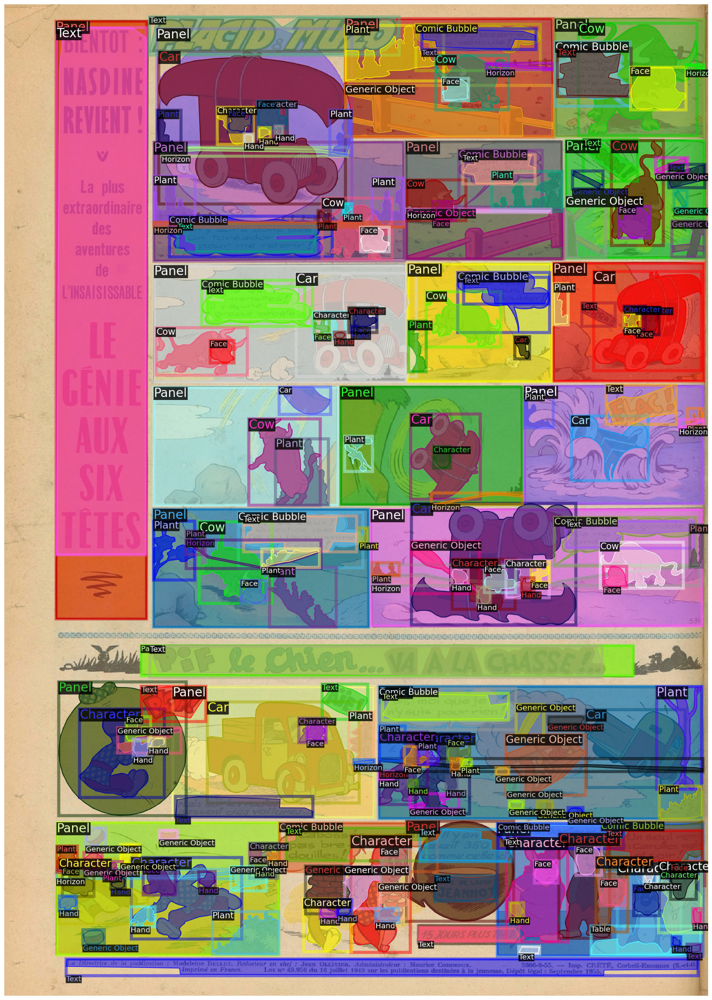

In [17]:
visualize_dataset_dict(sample, placid_metadata)

## Visualize Model Outputs

In [15]:
# Show panoptic/instance/semantic predictions

def show_seg_predictions(im, outputs, metadata):
    v = Visualizer(im[:, :, ::-1], metadata, scale=1.2, instance_mode=ColorMode.IMAGE_BW)
    panoptic_result = v.draw_panoptic_seg(outputs["panoptic_seg"][0].to("cpu"), outputs["panoptic_seg"][1]).get_image()
    v = Visualizer(im[:, :, ::-1], metadata, scale=1.2, instance_mode=ColorMode.IMAGE_BW)
    instance_result = v.draw_instance_predictions(outputs["instances"].to("cpu")).get_image()
    v = Visualizer(im[:, :, ::-1], metadata, scale=1.2, instance_mode=ColorMode.IMAGE_BW)
    semantic_result = v.draw_sem_seg(outputs["sem_seg"].argmax(0).to("cpu")).get_image()
    print("Panoptic segmentation (top), instance segmentation (middle), semantic segmentation (bottom)")
    res = np.concatenate((panoptic_result, instance_result, semantic_result), axis=0)[:, :, ::-1]
    plt.figure(figsize=(40, 30))
    plt.imshow(res)
    plt.axis('off')
    plt.show()

/scratch/shabanza/segmentation/Mask2Former/mask2former/modeling/transformer_decoder/position_encoding.py:41: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  dim_t = self.temperature ** (2 * (dim_t // 2) / self.num_pos_feats)
/scratch/shabanza/segmentation/Mask2Former/mask2former/modeling/transformer_decoder/position_encoding.py:41: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use 

Panoptic segmentation (top), instance segmentation (middle), semantic segmentation (bottom)


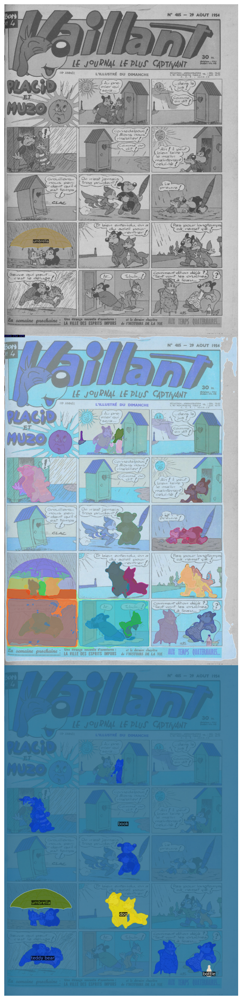

In [16]:
sample = random.choice(placid_dataset_dicts)
im = cv2.imread(sample["file_name"])
outputs = predictor(im)
show_seg_predictions(im, outputs, coco_metadata)

## Test with Panel Extracted

In [17]:
from src.dataset.helpers import get_panels

In [31]:
im = cv2.imread(sample["file_name"])
panels, cropped_boxes = get_panels(sample)

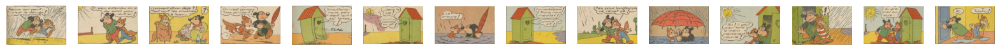

In [32]:
fig, axes = plt.subplots(1, len(panels), figsize=(20, 10))
for i, panel in enumerate(panels):
    axes[i].imshow(panel)
    axes[i].axis('off')

plt.show()

/scratch/shabanza/segmentation/Mask2Former/mask2former/modeling/transformer_decoder/position_encoding.py:41: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  dim_t = self.temperature ** (2 * (dim_t // 2) / self.num_pos_feats)
/scratch/shabanza/segmentation/Mask2Former/mask2former/modeling/transformer_decoder/position_encoding.py:41: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use 

Panoptic segmentation (top), instance segmentation (middle), semantic segmentation (bottom)


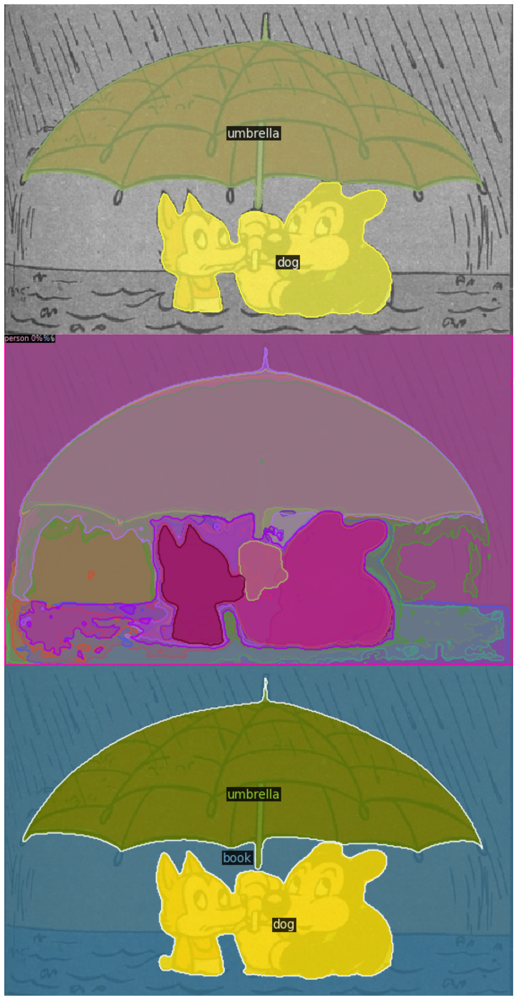

In [30]:
# Show panoptic/instance/semantic predictions

show_seg_predictions(panels[9], predictor(panels[9]), coco_metadata)

# Evaluation

In [10]:
import warnings
warnings.filterwarnings('ignore')

In [11]:
import seaborn as sns

def plot_confusion_matrix(confusion_matrix, labels):
    plt.figure(figsize=(30, 30))
    sns.heatmap(confusion_matrix, annot=True, cmap="Blues", fmt=".2f", xticklabels=labels, yticklabels=labels)
    plt.xlabel("Predicted")
    plt.ylabel("Actual")
    plt.title("Confusion Matrix")
    plt.show()

In [12]:
from src.evaluation.instance_evaluation import *
from src.evaluation.semantic_evaluation import *
from src.evaluation.helpers import *
from src.dataset.register_comic_instance import COMIC_CLASS_ID2CATEGORY

#### Sample: Instance - Page

In [106]:
evaluator = ComicInstanceEvaluator(PLACID_NAME)
im = cv2.imread(sample['file_name'])
outputs = predictor(im)
evaluator.process([sample], [outputs])
metrics = evaluator.evaluate()
print("mean_iou", metrics["mean_iou"])
print("iou_per_class:")
for class_id, iou in metrics["iou_per_class"].items():
    print(f"{COMIC_CLASS_ID2CATEGORY[class_id + 1]}: {iou}")

/scratch/shabanza/segmentation/Mask2Former/mask2former/modeling/transformer_decoder/position_encoding.py:41: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  dim_t = self.temperature ** (2 * (dim_t // 2) / self.num_pos_feats)
/scratch/shabanza/segmentation/Mask2Former/mask2former/modeling/transformer_decoder/position_encoding.py:41: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use 

mean_iou 0.00461885231270065
iou_per_class:
Generic Object: 0.06804973966553364
Car: 0.0
Bus: 0.0
Bicycle: 0.0
Motorbike: 0.0
Airplane: 0.0
Boat: 0.0
Train: 0.0
Chair: 0.0
Sofa: 0.0
Table: 0.0
Plant: 0.0
Cat: 0.0
Dog: 0.0
Cow: 0.0
Horse: 0.0
Sheep: 0.0
Bird: 0.0
Generic Animal: 0.0
Building: 0.0
Background: 0.0
Face: 0.0
Hand: 0.0
Horizon: 0.0
Panel: 0.0
Comic Bubble: 0.0
Text: 0.0
Character: 0.06127812509008456


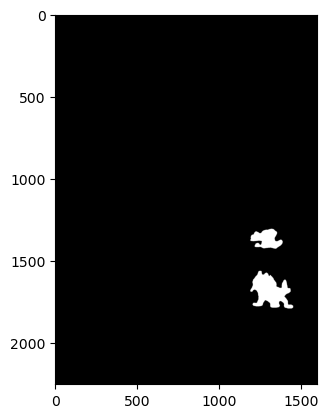

In [107]:
plt.imshow(outputs['instances'].pred_masks[0].cpu().numpy(), cmap="gray")  # Use "cmap" to specify the colormap (e.g., "gray" for grayscale)

#### Sample: Instance - Panel

In [108]:
evaluator2 = ComicInstanceEvaluator(PLACID_NAME)
outputs = predictor(panels[9])
evaluator.process([sample], [outputs], cropped_box=cropped_boxes[9])
metrics = evaluator.evaluate()
print("mean_iou", metrics["mean_iou"])
print("iou_per_class:")
for class_id, iou in metrics["iou_per_class"].items():
    print(f"{COMIC_CLASS_ID2CATEGORY[class_id + 1]}: {iou}")

/scratch/shabanza/segmentation/Mask2Former/mask2former/modeling/transformer_decoder/position_encoding.py:41: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  dim_t = self.temperature ** (2 * (dim_t // 2) / self.num_pos_feats)
/scratch/shabanza/segmentation/Mask2Former/mask2former/modeling/transformer_decoder/position_encoding.py:41: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use 

mean_iou 0.004674913543733477
iou_per_class:
Generic Object: 0.06738789484328946
Car: 0.0
Bus: 0.0
Bicycle: 0.0
Motorbike: 0.0
Airplane: 0.0
Boat: 0.0
Train: 0.0
Chair: 0.0
Sofa: 0.0
Table: 0.0
Plant: 0.0
Cat: 0.0
Dog: 0.0
Cow: 0.0
Horse: 0.0
Sheep: 0.0
Bird: 0.0
Generic Animal: 0.0
Building: 0.0
Background: 0.0
Face: 0.0
Hand: 0.0
Horizon: 0.0
Panel: 0.0
Comic Bubble: 0.0
Text: 0.0
Character: 0.06350968438124789


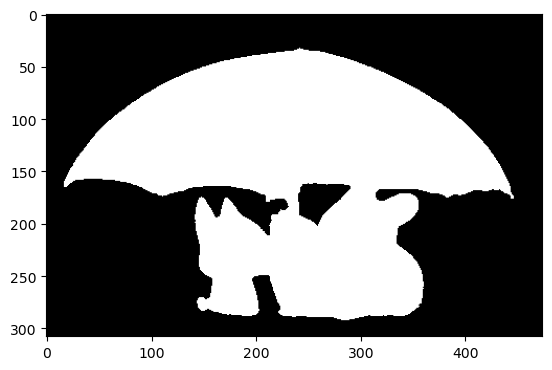

In [109]:
plt.imshow(outputs['instances'].pred_masks[0].cpu().numpy(), cmap="gray")

#### Sample: Semantic - Page

In [110]:
evaluator = ComicSemanticEvaluator(PLACID_NAME)
im = cv2.imread(sample['file_name'])
outputs = predictor(im)
evaluator.process([sample], [outputs])
metrics = evaluator.evaluate()
print("mean_iou", metrics["mean_iou"])
print("iou_per_class:")
for class_id, iou in metrics["iou_per_class"].items():
    print(f"{COMIC_CLASS_ID2CATEGORY[class_id + 1]}: {iou}")

/scratch/shabanza/segmentation/Mask2Former/mask2former/modeling/transformer_decoder/position_encoding.py:41: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  dim_t = self.temperature ** (2 * (dim_t // 2) / self.num_pos_feats)
/scratch/shabanza/segmentation/Mask2Former/mask2former/modeling/transformer_decoder/position_encoding.py:41: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use 

100%|██████████| 175/175 [00:06<00:00, 28.52it/s]

mean_iou 0.2702753554255774
iou_per_class:
Generic Object: 0.0689627194289338
Car: 0.0
Bus: 0.0
Bicycle: 0.0
Motorbike: 0.0
Airplane: 0.0
Boat: 0.0
Train: 0.0
Chair: 0.38617643289753767
Sofa: 0.0
Table: 0.0
Plant: 0.48551703164958726
Cat: 0.0
Dog: 0.0
Cow: 0.0
Horse: 0.0
Sheep: 0.0
Bird: 0.0
Generic Animal: 0.0
Building: 0.7587840670603226
Background: 0.0
Face: 0.8980409253991434
Hand: 0.8946624455831509
Horizon: 0.7757962875394097
Panel: 0.8149494351452435
Comic Bubble: 0.6771455749443307
Text: 0.9096341068693655
Character: 0.8980409253991434


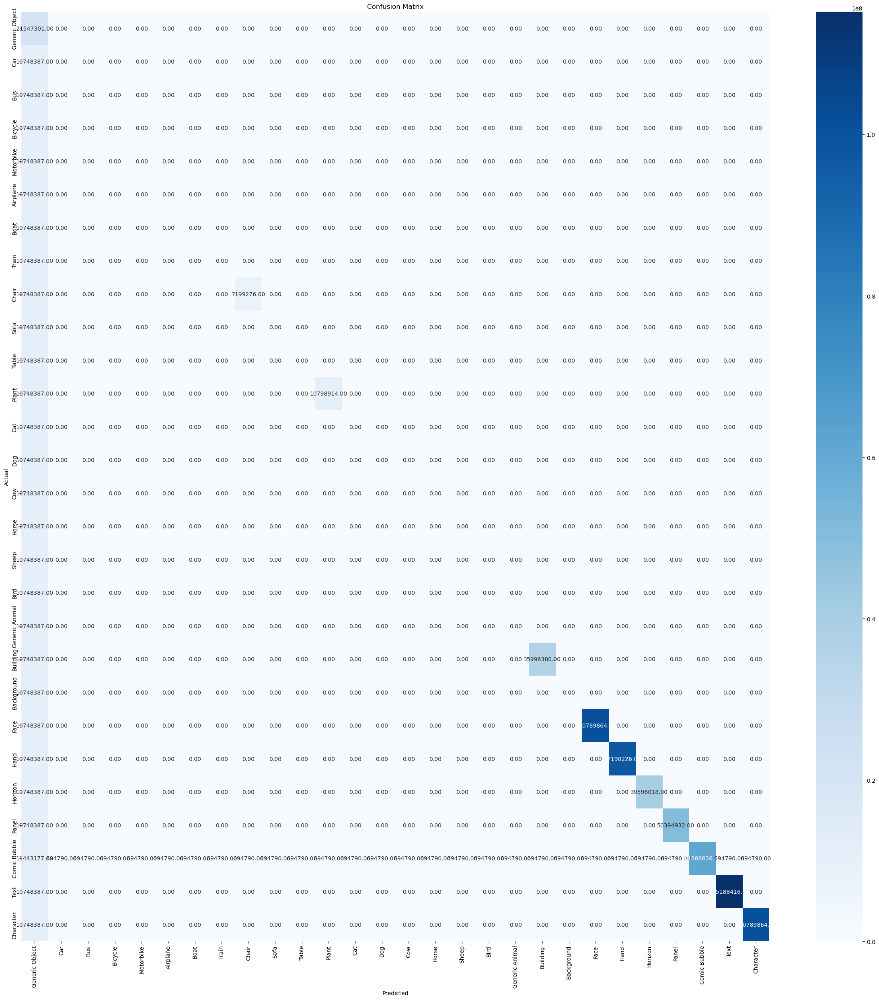

In [111]:
plot_confusion_matrix(evaluator.confusion_matrix, [k['name'] for k in COMIC_CATEGORIES])

#### Sample: Semantic - Panel

In [112]:
evaluator = ComicSemanticEvaluator(PLACID_NAME)
im = cv2.imread(sample['file_name'])
outputs = predictor(im)
evaluator.process([sample], [outputs])
metrics = evaluator.evaluate()
print("mean_iou", metrics["mean_iou"])
print("iou_per_class:")
for class_id, iou in metrics["iou_per_class"].items():
    print(f"{COMIC_CLASS_ID2CATEGORY[class_id + 1]}: {iou}")

/scratch/shabanza/segmentation/Mask2Former/mask2former/modeling/transformer_decoder/position_encoding.py:41: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  dim_t = self.temperature ** (2 * (dim_t // 2) / self.num_pos_feats)
/scratch/shabanza/segmentation/Mask2Former/mask2former/modeling/transformer_decoder/position_encoding.py:41: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use 

mean_iou 0.2702753554255774
iou_per_class:
Generic Object: 0.0689627194289338
Car: 0.0
Bus: 0.0
Bicycle: 0.0
Motorbike: 0.0
Airplane: 0.0
Boat: 0.0
Train: 0.0
Chair: 0.38617643289753767
Sofa: 0.0
Table: 0.0
Plant: 0.48551703164958726
Cat: 0.0
Dog: 0.0
Cow: 0.0
Horse: 0.0
Sheep: 0.0
Bird: 0.0
Generic Animal: 0.0
Building: 0.7587840670603226
Background: 0.0
Face: 0.8980409253991434
Hand: 0.8946624455831509
Horizon: 0.7757962875394097
Panel: 0.8149494351452435
Comic Bubble: 0.6771455749443307
Text: 0.9096341068693655
Character: 0.8980409253991434


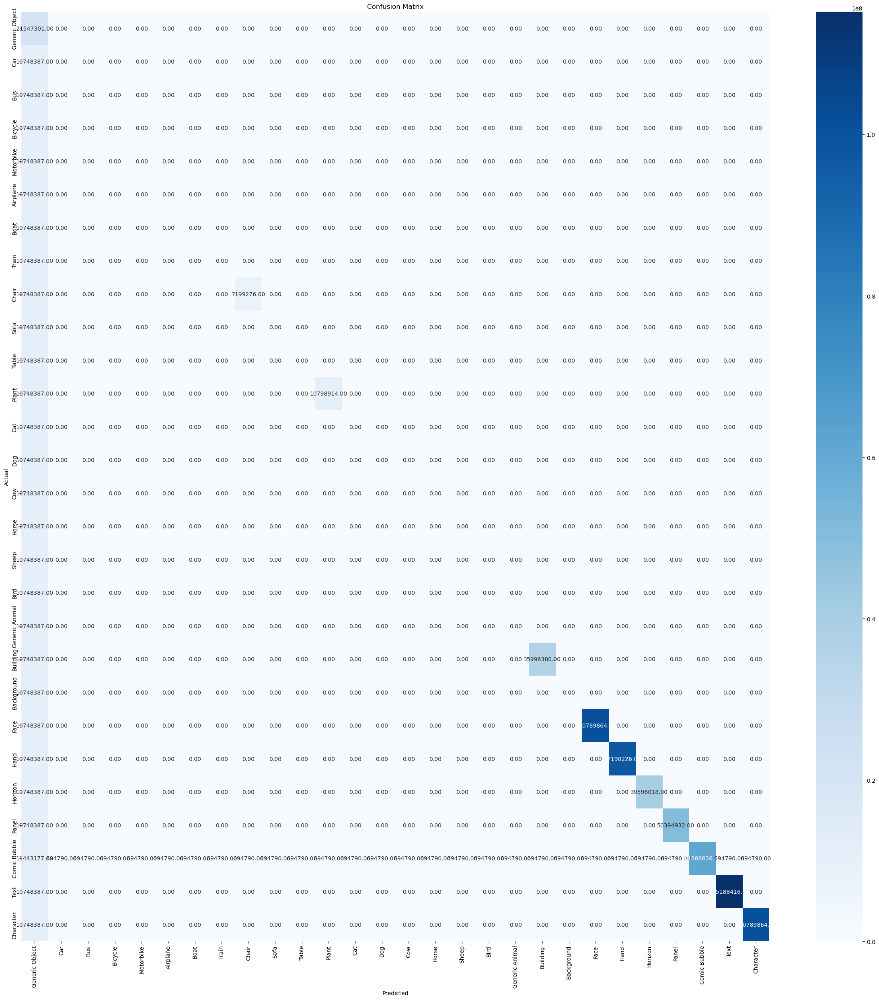

In [113]:
plot_confusion_matrix(evaluator.confusion_matrix, [k['name'] for k in COMIC_CATEGORIES])

### Semantic: Page-Wise

In [13]:
for dic in placid_dataset_dicts:
    if dic['image_id'] == 129:
        test = dic

In [19]:
evaluator = ComicSemanticEvaluator(PLACID_NAME)
for sample in tqdm(placid_dataset_dicts[:20]):
    im = cv2.imread(sample['file_name'])
    outputs = predictor(im)
    evaluator.process([sample], [outputs])
metrics = evaluator.evaluate()
print("mean_iou", metrics["mean_iou"])
print("iou_per_class:")
for class_id, iou in metrics["iou_per_class"].items():
    print(f"{COMIC_CLASS_ID2CATEGORY[class_id + 1]}: {iou}")

  0%|          | 0/20 [00:00<?, ?it/s]

Problem in annotations image_id = 129 in class 24!
Problem in annotations image_id = 129 in class 24!


Problem in annotations image_id = 129 in class 24!


  5%|▌         | 1/20 [00:04<01:23,  4.37s/it]

Problem in annotations image_id = 130 in class 24!


Problem in annotations image_id = 130 in class 24!


 10%|█         | 2/20 [00:09<01:22,  4.56s/it]

Problem in annotations image_id = 131 in class 24!
Problem in annotations image_id = 131 in class 24!


 15%|█▌        | 3/20 [00:14<01:27,  5.13s/it]

Problem in annotations image_id = 132 in class 24!


Problem in annotations image_id = 132 in class 24!


 25%|██▌       | 5/20 [00:25<01:18,  5.22s/it]

Problem in annotations image_id = 133 in class 24!
Problem in annotations image_id = 133 in class 24!


 35%|███▌      | 7/20 [00:34<01:01,  4.71s/it]

Problem in annotations image_id = 136 in class 24!


100%|██████████| 20/20 [01:34<00:00,  4.71s/it]

mean_iou 0.1529232129026085
iou_per_class:
Generic Object: 0.06892339642175738
Car: 0.035004723691465345
Bus: 0.008256307918802719
Bicycle: 0.0
Motorbike: 0.0457383412889815
Airplane: 0.0
Boat: 0.021762955746518795
Train: 0.0
Chair: 0.021746921243265587
Sofa: 0.002799531117650444
Table: 0.04505569073756717
Plant: 0.13729017091957618
Cat: 0.05261050705865328
Dog: 0.019191154502808616
Cow: 0.002830877909767308
Horse: 0.016748206815098463
Sheep: 0.0
Bird: 0.09131990059009513
Generic Animal: 0.04546477810054739
Building: 0.10710986268700193
Background: 0.0
Face: 0.6239654501773584
Hand: 0.6697647158107953
Horizon: 0.1865561630036795
Panel: 0.43790736184540097
Comic Bubble: 0.4606883127482303
Text: 0.5667809805354587
Character: 0.6143336504025578


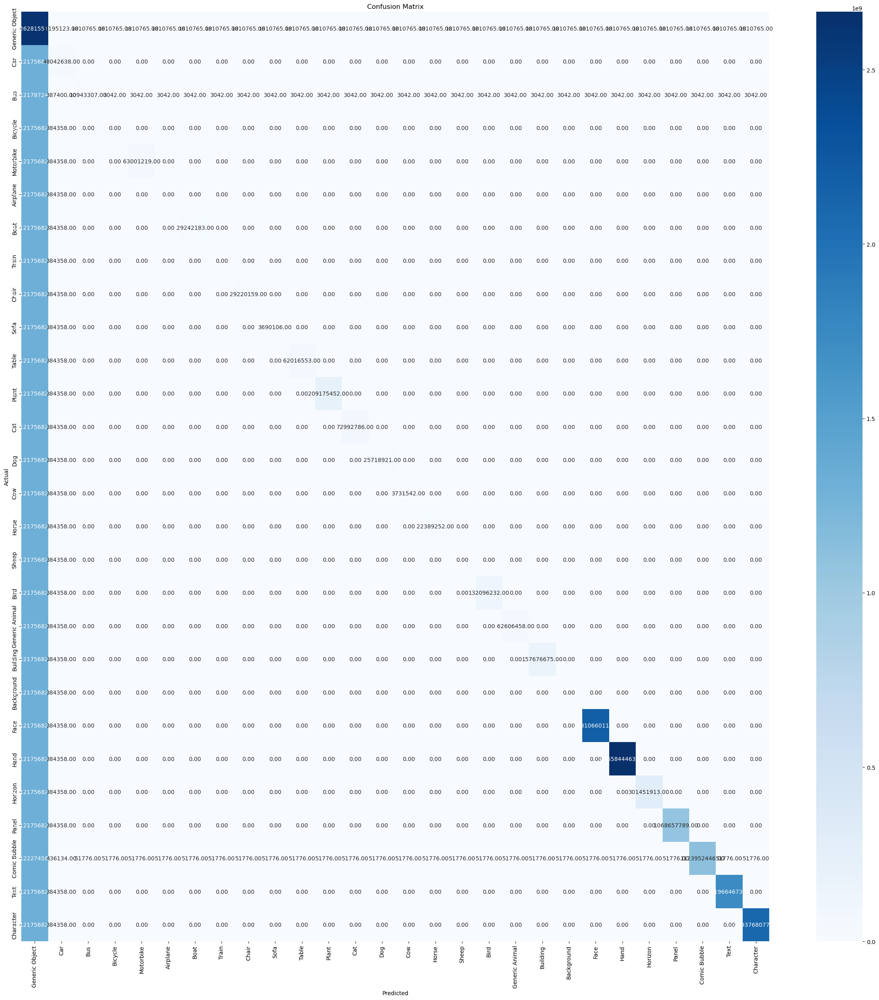

In [16]:
plot_confusion_matrix(evaluator.confusion_matrix, [k['name'] for k in COMIC_CATEGORIES])

Now add preprocessing to placid group:
 - median blur a little makes better
 - adaptive histogram equalization (MAKES BOTH BETTER, ESPECIALLY YVES)

In [47]:
evaluator = ComicSemanticEvaluator(PLACID_NAME)
for sample in tqdm(placid_dataset_dicts[:20]):
    im = cv2.imread(sample['file_name'])
    median = cv2.medianBlur(im, 5)
    outputs = predictor(median)
    evaluator.process([sample], [outputs])
metrics = evaluator.evaluate()
print("mean_iou", metrics["mean_iou"])
print("iou_per_class:")
for class_id, iou in metrics["iou_per_class"].items():
    print(f"{COMIC_CLASS_ID2CATEGORY[class_id + 1]}: {iou}")

  0%|          | 0/20 [00:00<?, ?it/s]


Problem in annotations image_id = 129 in class 24!
Problem in annotations image_id = 129 in class 24!


 58%|█████▊    | 100/171 [00:02<00:01, 44.01it/s]

Problem in annotations image_id = 129 in class 24!


  5%|▌         | 1/20 [00:04<01:24,  4.45s/it]

Problem in annotations image_id = 130 in class 24!


Problem in annotations image_id = 130 in class 24!


 10%|█         | 2/20 [00:09<01:22,  4.61s/it]

Problem in annotations image_id = 131 in class 24!
Problem in annotations image_id = 131 in class 24!


 15%|█▌        | 3/20 [00:15<01:27,  5.18s/it]

Problem in annotations image_id = 132 in class 24!


Problem in annotations image_id = 132 in class 24!


 25%|██▌       | 5/20 [00:26<01:20,  5.38s/it]

Problem in annotations image_id = 133 in class 24!
Problem in annotations image_id = 133 in class 24!


 35%|███▌      | 7/20 [00:35<01:03,  4.86s/it]

Problem in annotations image_id = 136 in class 24!


100%|██████████| 20/20 [01:35<00:00,  4.76s/it]

mean_iou 0.15300056134822285
iou_per_class:
Generic Object: 0.06895880852138908
Car: 0.03504046555704664
Bus: 0.008288487046850384
Bicycle: 0.0
Motorbike: 0.04576011844848654
Airplane: 0.0
Boat: 0.0217735780945284
Train: 0.0
Chair: 0.021788962744145816
Sofa: 0.0028009240512822044
Table: 0.04509952690437295
Plant: 0.1373492641457256
Cat: 0.05263537574866782
Dog: 0.019200546210670008
Cow: 0.002832286395998062
Horse: 0.01675642342542135
Sheep: 0.0
Bird: 0.09142205838314715
Generic Animal: 0.04548643121841701
Building: 0.10726088209751247
Background: 0.0
Face: 0.6242034171892687
Hand: 0.6700158288604257
Horizon: 0.18669438386291648
Panel: 0.43817271968431754
Comic Bubble: 0.46084591280675175
Text: 0.5670496201006142
Character: 0.6145796962522835


Now adaptive histogram equalization

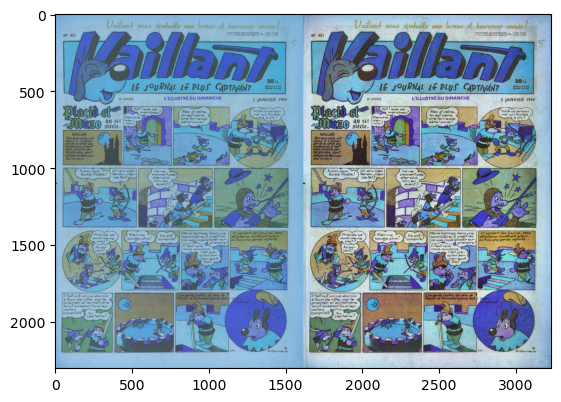

In [14]:
image = cv2.imread(test['file_name'])  # Read the image in grayscale

# Apply adaptive histogram equalization
b, g, r = cv2.split(image)

# Apply adaptive histogram equalization to each color channel
clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
equalized_b = clahe.apply(b)
equalized_g = clahe.apply(g)
equalized_r = clahe.apply(r)

# Merge the equalized color channels back into an image
equalized_image = cv2.merge([equalized_b, equalized_g, equalized_r])
compare = np.concatenate((image, equalized_image), axis=1) #side by side comparison

plt.imshow(compare)

In [21]:
evaluator = ComicSemanticEvaluator(PLACID_NAME)
for sample in tqdm(placid_dataset_dicts[:20]):
    im = cv2.imread(sample['file_name'])
    b, g, r = cv2.split(im)

    # Apply adaptive histogram equalization to each color channel
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    equalized_b = clahe.apply(b)
    equalized_g = clahe.apply(g)
    equalized_r = clahe.apply(r)

    # Merge the equalized color channels back into an image
    equalized_image = cv2.merge([equalized_b, equalized_g, equalized_r])
    outputs = predictor(equalized_image)
    evaluator.process([sample], [outputs])
metrics = evaluator.evaluate()
print("mean_iou", metrics["mean_iou"])
print("iou_per_class:")
for class_id, iou in metrics["iou_per_class"].items():
    print(f"{COMIC_CLASS_ID2CATEGORY[class_id + 1]}: {iou}")

  0%|          | 0/20 [00:00<?, ?it/s]

Problem in annotations image_id = 129 in class 24!
Problem in annotations image_id = 129 in class 24!


Problem in annotations image_id = 129 in class 24!


  5%|▌         | 1/20 [00:04<01:31,  4.83s/it]

Problem in annotations image_id = 130 in class 24!


Problem in annotations image_id = 130 in class 24!


 10%|█         | 2/20 [00:09<01:27,  4.88s/it]

Problem in annotations image_id = 131 in class 24!
Problem in annotations image_id = 131 in class 24!


 15%|█▌        | 3/20 [00:16<01:36,  5.65s/it]

Problem in annotations image_id = 132 in class 24!


Problem in annotations image_id = 132 in class 24!


 25%|██▌       | 5/20 [00:27<01:23,  5.55s/it]

Problem in annotations image_id = 133 in class 24!
Problem in annotations image_id = 133 in class 24!


 35%|███▌      | 7/20 [00:37<01:06,  5.12s/it]

Problem in annotations image_id = 136 in class 24!


100%|██████████| 20/20 [01:42<00:00,  5.11s/it]

mean_iou 0.153063823083748
iou_per_class:
Generic Object: 0.06898137971071601
Car: 0.03505469957845833
Bus: 0.008264886739394295
Bicycle: 0.0
Motorbike: 0.04577848003126368
Airplane: 0.0
Boat: 0.02178253460801437
Train: 0.0
Chair: 0.021814633886644754
Sofa: 0.0028020985605740067
Table: 0.045149235037351514
Plant: 0.13739908486804195
Cat: 0.05265634384711664
Dog: 0.01920846509611722
Cow: 0.0028334740190692456
Horse: 0.01676335150954142
Sheep: 0.0
Bird: 0.09154280054011542
Generic Animal: 0.04550468821910979
Building: 0.10733045330601491
Background: 0.0
Face: 0.6243585405543309
Hand: 0.670175327986678
Horizon: 0.1867700412688703
Panel: 0.4383587491661712
Comic Bubble: 0.4612680113356286
Text: 0.5672507070135564
Character: 0.6147390594621651


In [23]:
evaluator = ComicSemanticEvaluator(YVES_NAME)
for sample in tqdm(yves_dataset_dicts[:20]):
    im = cv2.imread(sample['file_name'])
    outputs = predictor(im)
    evaluator.process([sample], [outputs])
metrics = evaluator.evaluate()
print("mean_iou", metrics["mean_iou"])
print("iou_per_class:")
for class_id, iou in metrics["iou_per_class"].items():
    print(f"{COMIC_CLASS_ID2CATEGORY[class_id + 1]}: {iou}")

100%|██████████| 20/20 [01:23<00:00,  4.17s/it]

mean_iou 0.16856992290784673
iou_per_class:
Generic Object: 0.06856119224087695
Car: 0.0
Bus: 0.0
Bicycle: 0.0
Motorbike: 0.0
Airplane: 0.0
Boat: 0.0051516358698363756
Train: 0.0
Chair: 0.010342385822238204
Sofa: 0.0
Table: 0.015523624523439422
Plant: 0.4836948201364691
Cat: 0.02541317330983829
Dog: 0.0
Cow: 0.0
Horse: 0.3145418817025701
Sheep: 0.0
Bird: 0.030191357740032967
Generic Animal: 0.2550924225985302
Building: 0.10978156709663063
Background: 0.0
Face: 0.6493068291404283
Hand: 0.6284518440900201
Horizon: 0.2744704502373142
Panel: 0.5110040323630906
Comic Bubble: 0.0
Text: 0.5947871121667476
Character: 0.7436435123816452


In [24]:
evaluator = ComicSemanticEvaluator(YVES_NAME)
for sample in tqdm(yves_dataset_dicts[:20]):
    im = cv2.imread(sample['file_name'])
    median = cv2.medianBlur(im, 5)
    outputs = predictor(median)
    evaluator.process([sample], [outputs])
metrics = evaluator.evaluate()
print("mean_iou", metrics["mean_iou"])
print("iou_per_class:")
for class_id, iou in metrics["iou_per_class"].items():
    print(f"{COMIC_CLASS_ID2CATEGORY[class_id + 1]}: {iou}")

100%|██████████| 20/20 [01:20<00:00,  4.03s/it]

mean_iou 0.16801369990844436
iou_per_class:
Generic Object: 0.0683217519999866
Car: 0.0
Bus: 0.0
Bicycle: 0.0
Motorbike: 0.0
Airplane: 0.0
Boat: 0.004942386132551842
Train: 0.0
Chair: 0.01030265747361891
Sofa: 0.0
Table: 0.015437643594421662
Plant: 0.48259771071851865
Cat: 0.02533852162902358
Dog: 0.0
Cow: 0.0
Horse: 0.31333881850453577
Sheep: 0.0
Bird: 0.030133457238545894
Generic Animal: 0.25423284456769163
Building: 0.10824995935448034
Background: 0.0
Face: 0.6473361512473536
Hand: 0.6266832989908395
Horizon: 0.2731406215991544
Panel: 0.5092929377047744
Comic Bubble: 0.0
Text: 0.593098823747647
Character: 0.7419360129332991


In [22]:
evaluator = ComicSemanticEvaluator(YVES_NAME)
for sample in tqdm(yves_dataset_dicts[:20]):
    im = cv2.imread(sample['file_name'])
    b, g, r = cv2.split(im)

    # Apply adaptive histogram equalization to each color channel
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    equalized_b = clahe.apply(b)
    equalized_g = clahe.apply(g)
    equalized_r = clahe.apply(r)

    # Merge the equalized color channels back into an image
    equalized_image = cv2.merge([equalized_b, equalized_g, equalized_r])
    outputs = predictor(equalized_image)
    evaluator.process([sample], [outputs])
metrics = evaluator.evaluate()
print("mean_iou", metrics["mean_iou"])
print("iou_per_class:")
for class_id, iou in metrics["iou_per_class"].items():
    print(f"{COMIC_CLASS_ID2CATEGORY[class_id + 1]}: {iou}")

100%|██████████| 20/20 [01:31<00:00,  4.56s/it]

mean_iou 0.16778511735508986
iou_per_class:
Generic Object: 0.06820708809697598
Car: 0.0
Bus: 0.0
Bicycle: 0.0
Motorbike: 0.0
Airplane: 0.0
Boat: 0.005039257329784877
Train: 0.0
Chair: 0.010285812975598023
Sofa: 0.0
Table: 0.015253505217536269
Plant: 0.4815106695866615
Cat: 0.024758967548844064
Dog: 0.0
Cow: 0.0
Horse: 0.3113562626023671
Sheep: 0.0
Bird: 0.030092958402871794
Generic Animal: 0.2539376975764522
Building: 0.10905115631899502
Background: 0.0
Face: 0.6468911698066331
Hand: 0.6262622738863762
Horizon: 0.2724233929106318
Panel: 0.5087704725974456
Comic Bubble: 0.0
Text: 0.59240052308562
Character: 0.7417420779997228


In [39]:
evaluator = ComicSemanticEvaluator(PLACID_NAME)
im = cv2.imread(test['file_name'])
outputs = predictor(im)
evaluator.process([test], [outputs])
metrics = evaluator.evaluate()
print("mean_iou", metrics["mean_iou"])
print("iou_per_class:")
for class_id, iou in metrics["iou_per_class"].items():
    print(f"{COMIC_CLASS_ID2CATEGORY[class_id + 1]}: {iou}")

 56%|█████▌    | 95/171 [00:02<00:01, 43.94it/s]

Problem in annotations image_id = 129 in class 24!
Problem in annotations image_id = 129 in class 24!


 76%|███████▌  | 130/171 [00:02<00:00, 43.83it/s]

Problem in annotations image_id = 129 in class 24!


100%|██████████| 171/171 [00:03<00:00, 43.69it/s]

mean_iou 0.08667052885282822
iou_per_class:
Generic Object: 0.0689883782001876
Car: 0.0
Bus: 0.0
Bicycle: 0.0
Motorbike: 0.0
Airplane: 0.0
Boat: 0.0
Train: 0.0
Chair: 0.0
Sofa: 0.0
Table: 0.0
Plant: 0.0
Cat: 0.0
Dog: 0.0
Cow: 0.0
Horse: 0.0
Sheep: 0.0
Bird: 0.0
Generic Animal: 0.0
Building: 0.08338772617632509
Background: 0.0
Face: 0.4679191589664036
Hand: 0.528748804011592
Horizon: 0.0
Panel: 0.28275303727215867
Comic Bubble: 0.31265295491195677
Text: 0.2144055893741627
Character: 0.4679191589664036


In [46]:
evaluator = ComicSemanticEvaluator(PLACID_NAME)
outputs = predictor(median)
evaluator.process([test], [outputs])
metrics = evaluator.evaluate()
print("mean_iou", metrics["mean_iou"])
print("iou_per_class:")
for class_id, iou in metrics["iou_per_class"].items():
    print(f"{COMIC_CLASS_ID2CATEGORY[class_id + 1]}: {iou}")

 56%|█████▌    | 95/171 [00:02<00:01, 41.84it/s]

Problem in annotations image_id = 129 in class 24!
Problem in annotations image_id = 129 in class 24!


 76%|███████▌  | 130/171 [00:03<00:00, 42.51it/s]

Problem in annotations image_id = 129 in class 24!


 85%|████████▍ | 145/171 [00:03<00:00, 42.65it/s]

100%|██████████| 171/171 [00:04<00:00, 42.46it/s]

mean_iou 0.08660816166387049
iou_per_class:
Generic Object: 0.06894915468408021
Car: 0.0
Bus: 0.0
Bicycle: 0.0
Motorbike: 0.0
Airplane: 0.0
Boat: 0.0
Train: 0.0
Chair: 0.0
Sofa: 0.0
Table: 0.0
Plant: 0.0
Cat: 0.0
Dog: 0.0
Cow: 0.0
Horse: 0.0
Sheep: 0.0
Bird: 0.0
Generic Animal: 0.0
Building: 0.08329439974630147
Background: 0.0
Face: 0.4676150219664728
Hand: 0.5284444221497401
Horizon: 0.0
Panel: 0.28251487900665534
Comic Bubble: 0.31239048649521217
Text: 0.21419989575383272
Character: 0.4676202667860786


### Instance: Page-Wise

In [28]:
evaluator = ComicInstanceEvaluator(PLACID_NAME)

In [14]:
for sample in tqdm(placid_dataset_dicts[:50]):
    im = cv2.imread(sample['file_name'])
    outputs = predictor(im)
    evaluator.process([sample], [outputs])

100%|██████████| 50/50 [25:23<00:00, 30.47s/it]


In [15]:
metrics = evaluator.evaluate()
print("mean_iou", metrics["mean_iou"])
print("iou_per_class:")
for class_id, iou in metrics["iou_per_class"].items():
    print(f"{COMIC_CLASS_ID2CATEGORY[class_id + 1]}: {iou}")

mean_iou 0.0020970827903940632
iou_per_class:
Generic Object: 0.03568628606952978
Car: 0.0002909384784222491
Bus: 0.0
Bicycle: 0.0
Motorbike: 6.366844923333279e-06
Airplane: 0.0
Boat: 0.0009119004867063856
Train: 0.0
Chair: 0.00011185652988021742
Sofa: 2.3516861431386235e-05
Table: 0.000284674588159016
Plant: 0.0
Cat: 0.0003082359874924854
Dog: 0.0003014823859300534
Cow: 1.0544167363968035e-06
Horse: 0.0
Sheep: 0.0
Bird: 0.00015795554267150294
Generic Animal: 0.001017494789371493
Building: 0.0
Background: 0.0
Face: 0.0
Hand: 0.0
Horizon: 0.0
Panel: 0.0
Comic Bubble: 0.0
Text: 0.0
Character: 0.019616555149779474


#### yves

In [29]:
evaluator2 = ComicInstanceEvaluator(YVES_NAME)

In [ ]:
evaluate_page_wise(evaluator2, predictor, yves_dataset_dicts)

In [23]:
metrics = evaluator2.evaluate()
print("mean_iou", metrics["mean_iou"])
print("iou_per_class:")
for class_id, iou in metrics["iou_per_class"].items():
    print(f"{COMIC_CLASS_ID2CATEGORY[class_id + 1]}: {iou}")

mean_iou 0.0026549330436267194
iou_per_class:
Generic Object: 0.03493646757989524
Car: 0.0
Bus: 0.0
Bicycle: 0.0
Motorbike: 0.0
Airplane: 0.0
Boat: 0.0
Train: 0.0
Chair: 0.0
Sofa: 0.0
Table: 0.0
Plant: 0.0
Cat: 0.0
Dog: 0.0
Cow: 0.0
Horse: 0.0052624682590712655
Sheep: 0.0
Bird: 0.0
Generic Animal: 0.0
Building: 0.0
Background: 0.0
Face: 0.0
Hand: 0.0
Horizon: 0.0
Panel: 0.0
Comic Bubble: 0.0
Text: 0.0
Character: 0.03413918938258164


### Panel-Wise

#### placid

In [30]:
# Instance
panel_evaluator = ComicInstanceEvaluator(PLACID_NAME)
im = cv2.imread(sample['file_name'])
outputs = predictor(im)
panels, cropped_boxes = get_panels(sample)
for panel, cropped_box in tqdm(zip(panels, cropped_boxes)):
    outputs = predictor(panel)
    evaluator.process([sample], [outputs], cropped_box=cropped_box)
metrics = panel_evaluator.evaluate()
print("mean_iou", metrics["mean_iou"])
print("iou_per_class:")
for class_id, iou in metrics["iou_per_class"].items():
    print(f"{COMIC_CLASS_ID2CATEGORY[class_id + 1]}: {iou}")

22it [1:02:32, 170.59s/it]

mean_iou 0.0
iou_per_class:
Generic Object: 0.0
Car: 0.0
Bus: 0.0
Bicycle: 0.0
Motorbike: 0.0
Airplane: 0.0
Boat: 0.0
Train: 0.0
Chair: 0.0
Sofa: 0.0
Table: 0.0
Plant: 0.0
Cat: 0.0
Dog: 0.0
Cow: 0.0
Horse: 0.0
Sheep: 0.0
Bird: 0.0
Generic Animal: 0.0
Building: 0.0
Background: 0.0
Face: 0.0
Hand: 0.0
Horizon: 0.0
Panel: 0.0
Comic Bubble: 0.0
Text: 0.0
Character: 0.0


In [31]:
# Semantic
panel_evaluator = ComicSemanticEvaluator(PLACID_NAME)
im = cv2.imread(sample['file_name'])
outputs = predictor(im)
panels, cropped_boxes = get_panels(sample)
for panel, cropped_box in tqdm(zip(panels, cropped_boxes)):
    outputs = predictor(panel)
    evaluator.process([sample], [outputs], cropped_box=cropped_box)
metrics = panel_evaluator.evaluate()
print("mean_iou", metrics["mean_iou"])
print("iou_per_class:")
for class_id, iou in metrics["iou_per_class"].items():
    print(f"{COMIC_CLASS_ID2CATEGORY[class_id + 1]}: {iou}")

NameError: name 'ComicSemanticEvaluator' is not defined

In [18]:
panel_evaluator = ComicInstanceEvaluator(PLACID_NAME)
evaluate_panel_wise(panel_evaluator, predictor, placid_dataset_dicts[:50])

KeyboardInterrupt: 

In [19]:
metrics = panel_evaluator.evaluate()
print("mean_iou", metrics["mean_iou"])
print("iou_per_class:")
for class_id, iou in metrics["iou_per_class"].items():
    print(f"{COMIC_CLASS_ID2CATEGORY[class_id + 1]}: {iou}")

mean_iou 0.0023704668504285946
iou_per_class:
Generic Object: 0.03564147807252645
Car: 0.0
Bus: 0.0
Bicycle: 0.0
Motorbike: 0.0008861416347828899
Airplane: 0.0
Boat: 0.0
Train: 0.0
Chair: 9.760249652669012e-05
Sofa: 0.0
Table: 0.00011973545124638256
Plant: 0.0
Cat: 0.0
Dog: 0.0
Cow: 2.4726689842577278e-05
Horse: 0.0039209069127506295
Sheep: 0.0
Bird: 0.0011602346096456515
Generic Animal: 9.786213954921123e-06
Building: 0.0
Background: 0.0
Face: 0.0
Hand: 0.0
Horizon: 0.0
Panel: 0.0
Comic Bubble: 0.0
Text: 0.0
Character: 0.024512459730724464


#### yves

In [26]:
panel_evaluator2 = ComicInstanceEvaluator(PLACID_NAME)

In [27]:
evaluate_panel_wise(panel_evaluator2, predictor, placid_dataset_dicts)

KeyboardInterrupt: 

In [29]:
metrics = panel_evaluator2.evaluate()
print("mean_iou", metrics["mean_iou"])
print("iou_per_class:")
for class_id, iou in metrics["iou_per_class"].items():
    print(f"{COMIC_CLASS_ID2CATEGORY[class_id + 1]}: {iou}")

mean_iou 0.0030701802554291926
iou_per_class:
Generic Object: 0.03561760980255012
Car: 0.0
Bus: 0.0
Bicycle: 0.0
Motorbike: 0.0
Airplane: 0.0
Boat: 0.0
Train: 0.0
Chair: 0.0011365269250323174
Sofa: 0.0
Table: 0.0031451922544447034
Plant: 0.0
Cat: 0.0
Dog: 0.0
Cow: 0.0
Horse: 0.0
Sheep: 0.0
Bird: 0.02361175260904566
Generic Animal: 0.0
Building: 0.0
Background: 0.0
Face: 0.0
Hand: 0.0
Horizon: 0.0
Panel: 0.0
Comic Bubble: 0.0
Text: 0.0
Character: 0.022453965560944596


### Visualize Samples

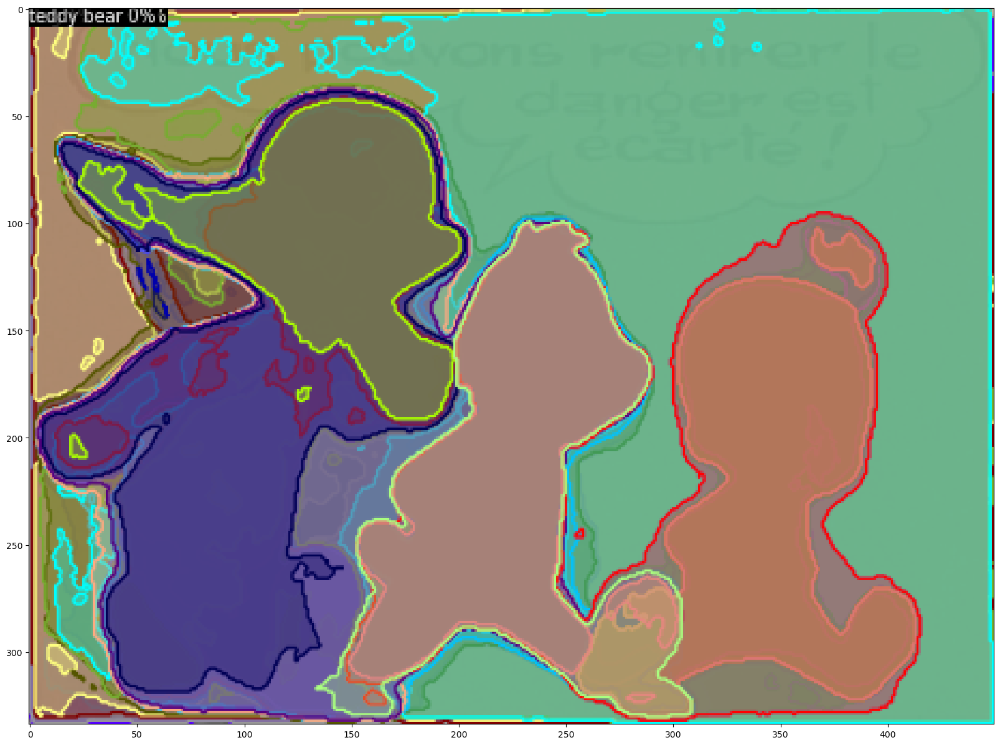

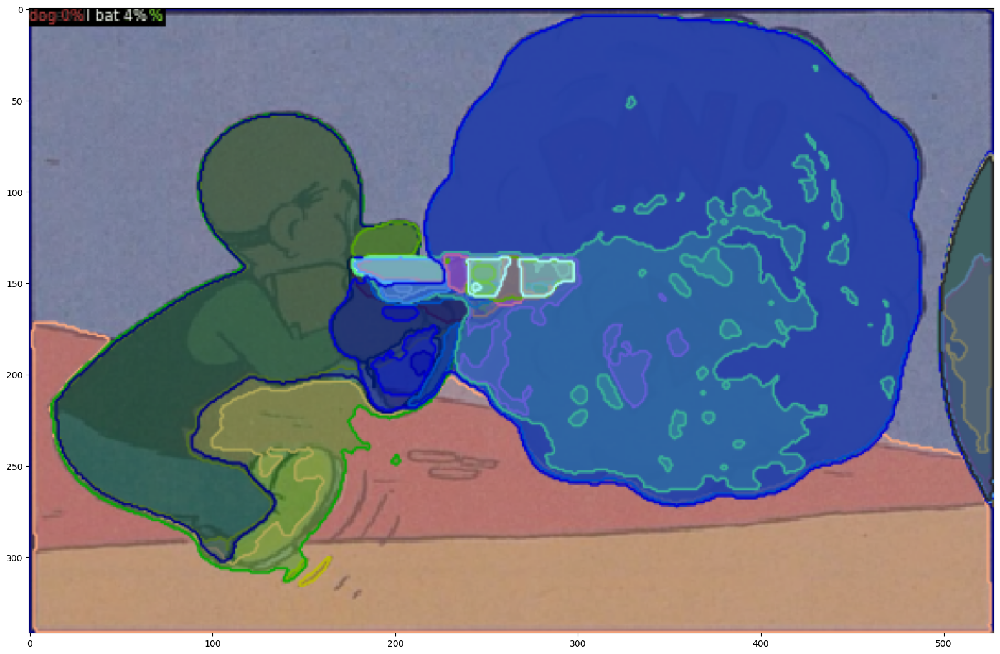

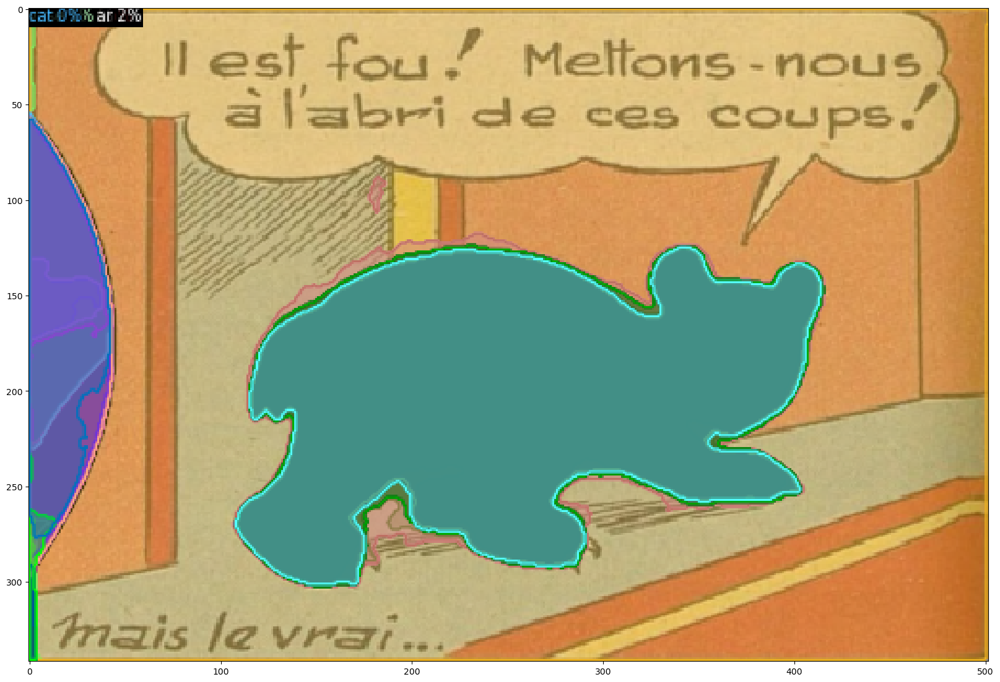

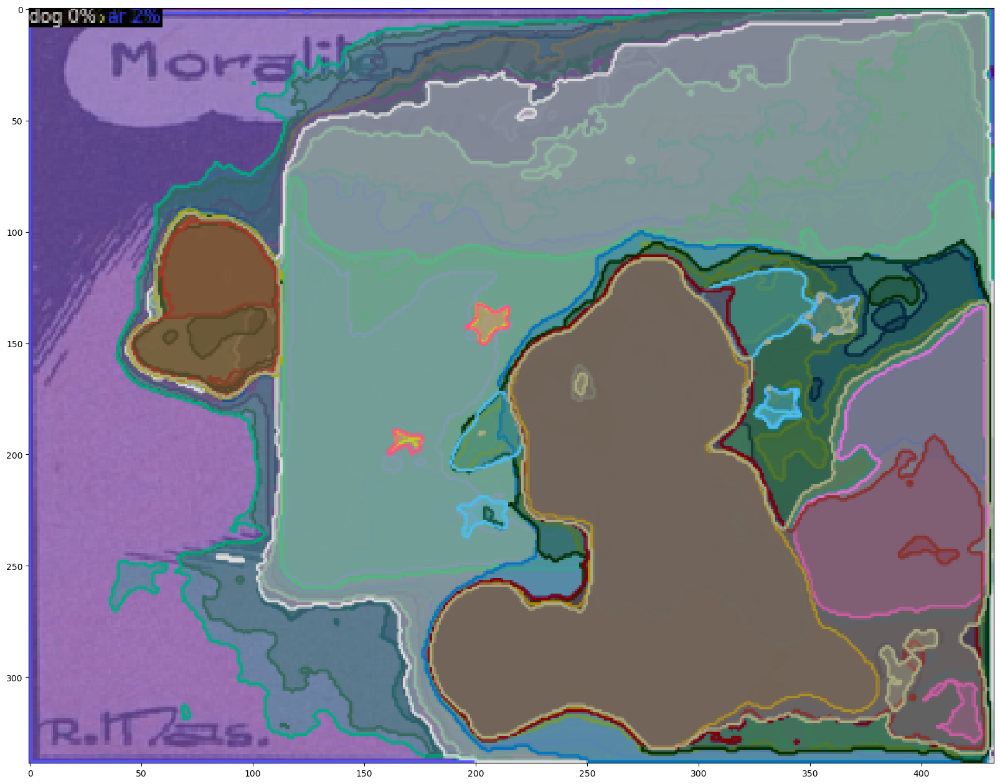

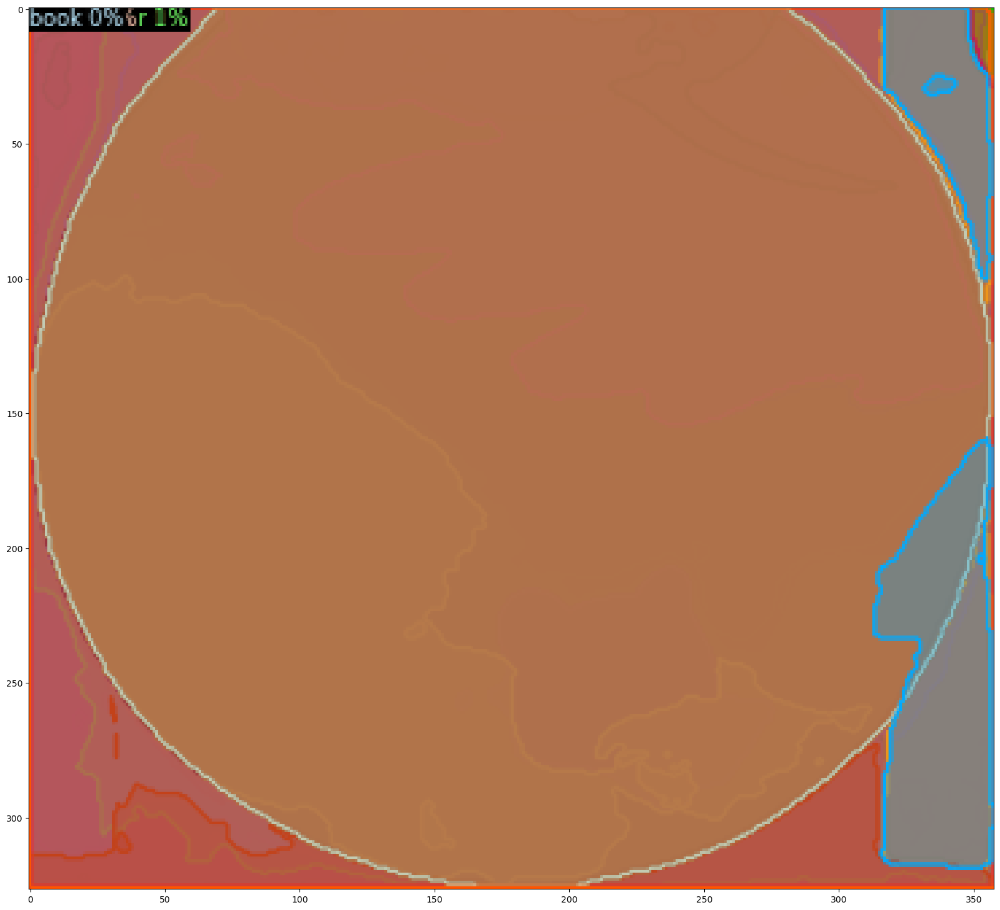

In [72]:
im = cv2.imread(sample["file_name"])
panelsو_ = get_panels(sample)
for panel in panels:
    outputs = predictor(panel)
    v = Visualizer(panel, coco_metadata, scale=1.2, instance_mode=ColorMode.IMAGE_BW)
    instance_result = v.draw_instance_predictions(outputs["instances"].to("cpu")).get_image()
    plt.figure(figsize=(20, 20))
    plt.imshow(instance_result)
    plt.show()